# Final Project: High-Dynamic Range Imaging (HDR) Using Debevec-Malik Method And Homographic Image Alignment

**Name:** Amardeep Sarang


## Introduction and set up

### Abstract 
Modern digital photography and displays uses 24 bits to store image pixel information, where each RGB channel uses 8-bit values from 0-255. These values are not always enough the capture all the detail one may want to capture when photographing real scenes. To get around this a camera will adjust its exposures to capture the highest dynamic range of colors it can and any colors falling outside the range will be clipped. This can result in images having oversaturated and dark regions which result in loss of detail.  A way to get around this is to take multiple images of the same frame in quick succession with no movement at different exposures. These different exposures can then be combined into one image which will have a higher dynamic range of color values and thus more details. This process is called high-dynamic-range imaging or HDR.

In this project, I have implemented the Debevec-Malik Method of generating HDR composite images from multiple different exposures of an image. This method uses know exposure times from each image to combine them. I will present a walkthrough of my implementation of the Debevec-Malik Method where I will show the steps of estimating the radiometric response function, blending pixels from different exposures to create a radiance map, and finally, applying tone mapping algorithms to map the HDR image to a displayable gamut. I will then apply my implementation to multiple sample images and discuss the results. I will also discuss the use of different tone mapping algorithms on the final results. 

The second part of this project will be the implementation of an alignment algorithm using homographies and RANSAC model fitting. This is an important enhancement to my project as HDR algorithms like the Debevec-Malik Method assume that the different exposure images are perfectly aligned. Having an auto-alignment algorithm means I will be able to drop the requirement of using a tripod for multi-exposure shots or needing to find pre-aligned samples. I will discuss some of the unique challenges faced when implementing an alignment algorithm to align images with different exposures. Finally, I will show samples that were processed by the alignment algorithm before using the Debevec-Malik Method to get their HDR composite and compare this to HDR images created using non-aligned images.


### Code libraries
Most libraries used in this project are installed with the default anaconda package. Most of these libraires are common and have been used in previous course assignments these include numpuy matplotlib, and the python math library

Another library used was skimage. This library was used for the alignment of images using its feature detection, and RANSAC implementation. It comes pre installed with the default anaconda package.

The last library used was OpenCV (cv2). It was used for loading and resizing images as well as for some of its reimplemented tone mapping algorithms It **does not** come pre installed with the default anaconda package. To install please type: *conda install -c conda-forge opencv* in the anaconda prompt.


In [1]:
import matplotlib.image as image
import numpy as np
import numpy.linalg as la
import matplotlib.pyplot as plt
import math
import cv2# install with pip, used for image loading and tone mapping

#used for image alignment
from skimage.feature import (corner_harris, corner_peaks, plot_matches, BRIEF, match_descriptors)
from skimage.transform import warp, ProjectiveTransform
from skimage.color import rgb2gray
from skimage.measure import ransac
from skimage import exposure

In [2]:
#constants
IMG_FOLDER="images/"
RESULTS_FOLDER="final_results/"
BGR_LABLES=["B","G","R"]# BGR instead of RGB in cv2
L=50 #lambda
Z_MAX=256
Z_MIN=0

### Instruction for loading images
In order for my software to create the HDR composite it requires a set of images taken at different exposures and then it will combine them. The exposure time of each image must be known. Such an image set can be created using exposure bracketing mode on some advance camera apps like on the *Manual Camera* app on android.

The set of images are expected to be accompanied by an .txt file containing the list of file names of all images belonging to the set, along with their exposure times. The format of the file is expected to be the image file name and exposure time separated by a space, with each image record being on a new line. When making this list one can find the exposure time for most images in their metadata which can be viewed on Windows in the *Details* tab of the *properties* window for each image.

All images to be processed and the *image_list* txt file  should put in the image folder. Which by default is assumed to be a subfolder of the folder where this notebook is located. The location of this directory should be found can be changed by changing the *IMG_FOLDER* path variable at the top of this notebook. Similarly, the location where the final HDR images will be saved can also be changed by editing the *RESULTS_FOLDER* variable.


## HDR basic processing steps
This section will implement and walkthrough the steps of constructing a HDR using Debevec-Malik Method.

### Loading images

The Debevec-Malik method assumes that exposure values are known. My implementation requires a text file that list the different file names exposure images in the same set along with their exposure times. These exposure times can be found in the image properties of most images.

This first step loads the images of the set and their exposure times into lists.

In [3]:
"""
-------------------------------------------------------------------------------------------------------------------------
Parameters:   image_list_f_name (str) - name file that lists file names of images and their exposure time, or shutter speeds
             
Description:  gets img file names and exposure values from file, returns them as 2 lists  
--------------------------------------------------------------------------------------------------------------------------
"""
def get_exposure_and_file_names(image_list_f_name):
    #gets img file names and exposure values from file
    
    f=open(image_list_f_name,"r")
    
    f_names=[]
    exposures=[]
    
    for line in f:
        line_list=line.split()
        f_names.append(line_list[0])
        exposures.append(float(line_list[1]))
    return f_names, exposures

"""
-------------------------------------------------------------------------------------------------------------------------
Parameters:   img_f_names ( list of str) - list of image file names to be read into an arrar
              pre_fix (str) - path to folder with images in it (assumes alll images located in same folder)
              channel (int) - specifies RGB channel needed (optional)
Description:  gets a list imgs (list of np arrays) of images in list of image file names, if channel is specified only 
                includes array values from that channel 
--------------------------------------------------------------------------------------------------------------------------
"""
def load_images(img_f_names,pre_fix="",channel=-1):
    images=[]
    for f_name in img_f_names:
        
        im = cv2.imread(pre_fix+f_name,1)
        
        if channel>=0 and channel<=2:
            images.append(im[:,:,channel])# only get specified RGB channel 
        else:
            im=cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
            images.append(im)
        
    return images

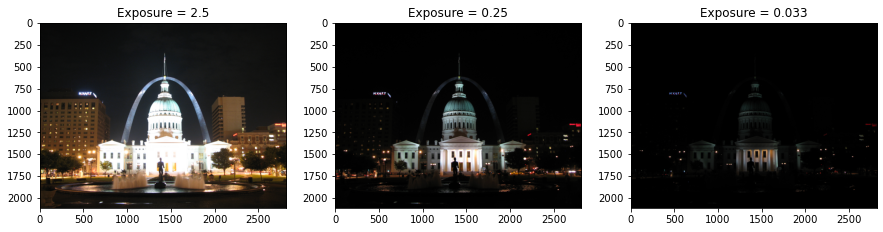

In [4]:
#gets img file names and exposure values from file
f_names, exposures= get_exposure_and_file_names(IMG_FOLDER+"StLouisArch_image_list.txt")
#load imsges
images=load_images(f_names,IMG_FOLDER)

#shows samples of the images being used

sample_im=images[0]
sample_exp=exposures[0]
fig = plt.figure(figsize = (15, 4))
plt.subplot(131)
plt.title('Exposure = {}'.format(sample_exp))
plt.imshow(sample_im)

sample_im=images[len(images)//2]
sample_exp=exposures[len(exposures)//2]
plt.subplot(132)
plt.title('Exposure = {}'.format(sample_exp))
plt.imshow(sample_im)

sample_im=images[-1]
sample_exp=exposures[-1]
plt.subplot(133)
plt.title('Exposure = {}'.format(sample_exp))
plt.imshow(sample_im)



### Debevec-Malik HDR
The response function is a function that maps the pixel value to a log irradiance (log exposure value). The code below is used to estimate the response function for all image values from 0-255, it uses equation (3) from the Debevec-Malik paper to ensure that pixel values from different exposures align in a smooth ‘S’ curve shape. The code will solve equation (3) using the least square SVD decomposition. This is repeated and a separate response function is recovered for each RBG channel.

The first test gives a fairly smooth response curve but there is some “wobble” likely due to the image being misaligned. See “Mountains” and “Ostrów Tumski” examples for a very smooth curve.  


In [5]:
"""
-------------------------------------------------------------------------------------------------------------------------
Parameters: im_list (list of np arrays) - a list of images
            exposure_times(j) (list of floats)-   is the exposure times, or shutter speed, for image j
Description: Preparas the parameters needed for solve_dm_response_function before calling it to solve

Returns:    g(z) is the log exposure corresponding to pixel value z
            lE(i) is the log film irradiance at pixel location i

--------------------------------------------------------------------------------------------------------------------------
"""
def hdr_debevec_malik(im_list,exposure_times,l=L,sample_size=30):
    
    B=np.log2(np.array(exposure_times))
    w=get_weights(Z_MIN,Z_MAX)
    
    #make Z array, which is a 2x2 array of the flattened images
    im_l=im_list[0].shape[0]
    im_h=im_list[0].shape[1]
    list_len=len(im_list)
    Z=np.zeros((list_len,sample_size*sample_size))
    
    #print(Z.shape,im_l*im_h)
    #geterate sample indexes
    #sample_i=np.random.choice(im_l*im_h,sample_size,replace=False)
    i=0
    for im in im_list:
        #resize image to get a samling
        im=cv2.resize(im,(sample_size,sample_size))
        
        flat_im=im.flatten()
        Z[i]=flat_im
        i+=1
        
    
    return solve_dm_response_function(Z,B,l,w)

"""
-------------------------------------------------------------------------------------------------------------------------
Parameters: z_max (int) - max of range
            z_min (int) - min of range
Description: This function calculates weights discribed in eqation (4) of Debevec-Malik paper
--------------------------------------------------------------------------------------------------------------------------
"""
def get_weights(z_min,z_max): 
    w=[]
    for z in range(z_min,z_max):
        if z <= (z_max+z_min)*0.5:
            w.append(z-z_min+1)
        else:
            w.append(z_max-z+1)
    return w

"""
-------------------------------------------------------------------------------------------------------------------------
Parameters: Z(i,j) (1d numpy array, flatted from 2d) - is the pixel values of pixel location number i in image j
            B(j) (1d numpy )-   is the log delta t, or log shutter speed, for image j
            l (float) - is lamdba, the constant that determines the amount of smoothness
            w(z)  (1d numpy )  -  is the weighting function value for pixel value z in the range [0,255]

Description: This function slovea imaging system’s response function g as well as the log film irradiance
                values for the observed pixels. It implements the gsolve.m Matlab code found in Appendix A of the 
                Debevec-Malik paper

Returns:    g(z) (1d numpy ) - is the log exposure corresponding to pixel value z
            lE(i) (1d numpy ) - is the log film irradiance at pixel location i

--------------------------------------------------------------------------------------------------------------------------
"""
def solve_dm_response_function(Z,B,l,w):
    n=Z_MAX
    
    z1=Z.shape[1]
    z2=Z.shape[0]
    A=np.zeros((z1*z2+n+1,n+z1), dtype=np.float32)
    b=np.zeros((A.shape[0]), dtype=np.float32)
    
    # Include the data−fitting equations
    
    k=0
    for i in range(z1):
        for j in range(z2):
            z=int(Z[j,i])
            wij= w[z]
            A[k,z]=wij
            A[k,n+i]=-1*wij
            b[k]=wij*B[j]
            
            k+=1
            
    #Fix the curve by setting its middle value to 0
    A[k,128]=1
    k+=1
    
    #Include the smoothness equations
    
    for i in range(n-1):
        A[k,i]=l*w[i+1]
        A[k,i+1]=-2*l*w[i+1]
        A[k,i+2]=l*w[i+1]
        k+=1
        
    # Solve the system using SVD
    x = np.linalg.lstsq(A, b,rcond=None)[0]
    g = x[:n]
    lE = x[n:]

    return g, lE

### Testing and display of the Recovered response function

In [6]:
#load image from each RGB channel
im_b=load_images(f_names,IMG_FOLDER,0)
im_g=load_images(f_names,IMG_FOLDER,1)
im_r=load_images(f_names,IMG_FOLDER,2)


In [7]:
def plot_response_curve(g_funcs):
    #plot response functions
    y_range=range(Z_MAX)

    plt.figure(figsize=(10,10))
    plt.title("Response curve")
    plt.plot(g_funcs[0],y_range, 'rx')
    plt.plot(g_funcs[1],y_range, 'gx')
    plt.plot(g_funcs[2],y_range, 'bx')
    plt.ylabel('pixel value Z')
    plt.xlabel('log exposure X')
    plt.show()

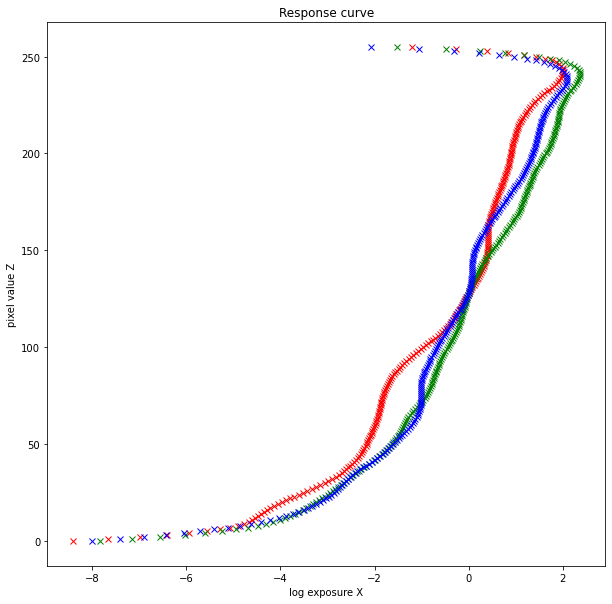

In [8]:
#estimate response functions for each channel
gr,_=hdr_debevec_malik(im_r,exposures)
gg,_=hdr_debevec_malik(im_g,exposures)
gb,_=hdr_debevec_malik(im_b,exposures)

#plot response functions
plot_response_curve([gr,gg,gb])

### Constructing the High Dynamic Range Radiance Map
The next step is to construct a radiance map where each pixel in the image is given a radiance value. We can use the estimated response functions to do so by mapping pixel values to relative radiance values. Since the estimated response functions are not entirely accurate due to noise, we can combine the values for the pixel from multiple exposures for robustness. The Debevec-Malik paper proposes doing this by using a weighted function that will favor using the value from exposure images where the pixel’s value is closer to the middle of the response function. This will make it less likely the value being used is under or overexposed. This process can be achieved by calculating the radiance using equation (6) from the Debevec-Malik paper and is what I implemented to compute the radiance map in the code beloe.


In [9]:
"""
-------------------------------------------------------------------------------------------------------------------------
Parameters: img (list of 2d numpy )- is a list of j np arrays of pixel values of each of the j images (only a single rgb channel)
            g(z) is the log exposure (response function) corresponding to pixel value z
            log_exposures(j) (1d numpy ) -   is the  delta t, or log shutter speed, for image j
            

Description: This function creates a radiance map using the eltimated response function. It does this by calculating the 
                relative radiance values at each pixel in each image it then take the weighted average the value over all images.
                This is done according to equation (6) outlined in the Debevec-Malik paper

--------------------------------------------------------------------------------------------------------------------------
"""
def get_radiance_map(img_list,g,exposure_times):
    w=get_weights(Z_MIN,Z_MAX)
    w=np.array(w)
    log_exposures_times=np.log2(np.array(exposure_times))
    
    j=0
    numerator=np.zeros(img_list[0].shape)
    denominator=np.zeros(img_list[0].shape)
    
    #calculate eqation (6)
    for img in img_list:
        #img=img.astype("int")
        
        numerator=numerator+w[img]*(g[img]-log_exposures_times[j])
        denominator=denominator+w[img]
        
        j+=1
        
    radiance_map=numerator/denominator
    #radiance_map=np.where(denominator!=0,numerator/denominator,numerator)
    return radiance_map
    
    

### Merging radiance map from all channels and diplaying it
The radiance map is computed separately for each RBG channel using its respective response function. Below I display the radiance map for each channel using a heat map and then I also combine the radiance map for each channel into a single 3d array, this composite radiance map is also displayed. Note a heat map must be used since the radiance map values can be in the range $[0,\inf)$ and thus cannot be displayed as-is.


In [10]:
"""
-------------------------------------------------------------------------------------------------------------------------
Parameters: img (list of a list of 2d numpy )- is a 3 list of lists j np arrays of pixel values of each of the j images, 
                each index of the top level list a list of j np arrays of pixel values of each of the j images for each channel
                index are in BGR order
            response_funcs (list of response funtions) - is a list of log exposure (response function) corresponding 
                to pixel value g(z) for each color channel, index are in BGR order
            exposures(j) (1d numpy ) -   is the  delta t, or log shutter speed, for image j
            display_steps (bool) - toggle for displaying radince maps

Description: This function creates a radiance map using the eltimated response function. It does this by calculating the 
                relative radiance values in each channel at each pixel in each image it then take the 
                weighted average the value over all images. Then all channels are combine into a hdr radiance nap
                

--------------------------------------------------------------------------------------------------------------------------
"""
def construct_HDR(imgs,response_funcs,exposures,display_steps=False):
    full_rad_map=np.zeros((im_b[0].shape[0], im_b[0].shape[1],3))
    
    if display_steps:#display radince maps if specified
        plt.figure(figsize=(20,20))

    for i in range(3):
        #calculating the radiance values at each pixel according to equation (6) outlined in the Debevec-Malik paper
        radiance_map=get_radiance_map(imgs[i],response_funcs[i],exposures)
        
        if display_steps:
            plt.subplot(1,3,i+1)
            plt.title("Radiance map for {} channel".format(BGR_LABLES[i]))
            radiance_map=get_radiance_map(imgs[i],response_funcs[i],exposures)
            plt.imshow(radiance_map,cmap="jet")
            
        full_rad_map[...,i]=radiance_map# to returns ln of radince values
        
    hdr=np.exp2(full_rad_map)# get orginal  radince values
    
    if display_steps:
        plt.show()#BGR channels
        
        #show full hdr map
        plt.figure(figsize=(20,20))
        plt.title("Radiance map for all channels (HRD)")
        plt.imshow(cv2.cvtColor(np.float32(full_rad_map), cv2.COLOR_BGR2GRAY),cmap="jet")

        
        
    return hdr

### Displaying merged radiance map

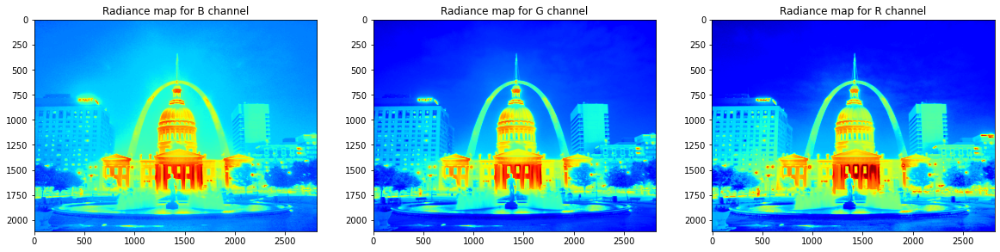

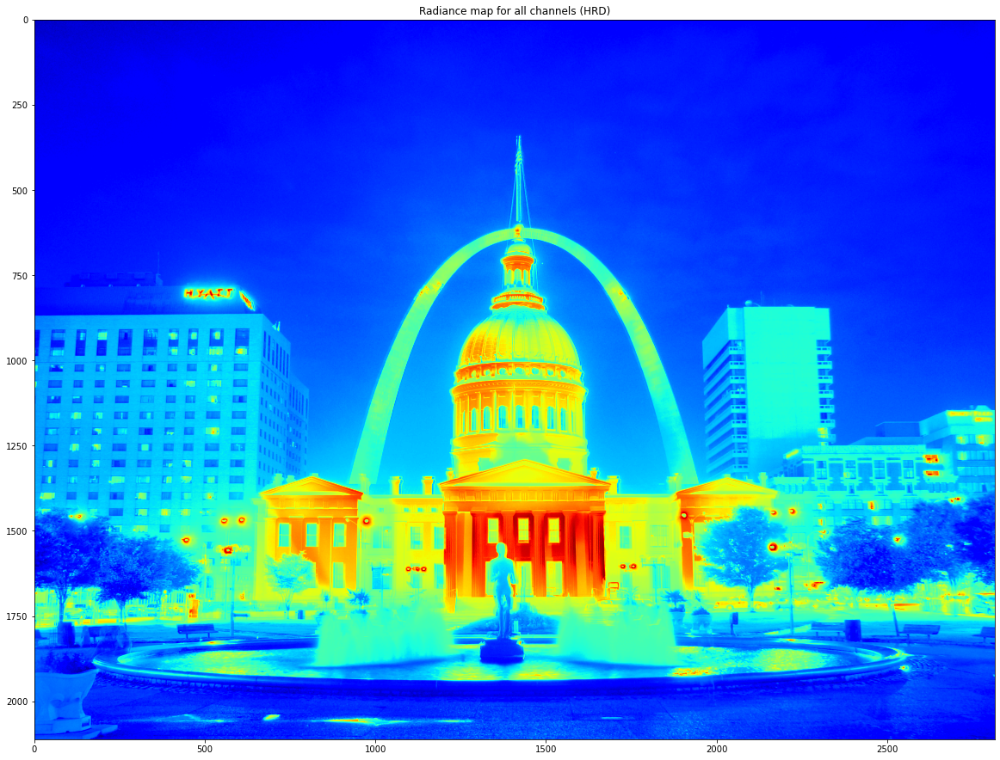

In [11]:
imgs=[im_b,im_g,im_r]
response_funcs=[gb,gg,gr]
hdr=construct_HDR([im_b,im_g,im_r],[gb,gg,gr],exposures,display_steps=True)


### Tone mapping to final image
As mentioned in the step above, radiance map values can be in the range $[0,\inf)$ and thus cannot be displayed as-is. Tone mapping is the process of taking radiance map values that can be in the range $[0,\inf)$ and converting then is to an 8-bit displayable gamut with values with the range $[0, 255]$. This is the last step in the HDR processing pipeline and will result in a displayable HDR image that is shown below.  There are multiple different tone mapping algorithms, each with pros, cons, and each giving a slightly different look to the final image. Furthermore, each algorithm has its parameters that can be tweaked to adjust the final output. I will be experimenting with different tone mapping algorithms in the examples below.

In [12]:
"""
-------------------------------------------------------------------------------------------------------------------------
Parameters: hdr (3d np arrays) - a array of image which has dimensions l x w x 3 for a 
                given image with 3 BGR (because cv2) channels valuees from [0,inf)
            args( (list 4 of floats)-   the arguments for the cv2 TonemapReinhard function 
                see https://www.kite.com/python/docs/cv2.createTonemapReinhard
Description: Applies Reinhard tonemap to hdr radiance map and then returns tonemaped RGB, 
                and BGR image with pixel in range [0,255]

--------------------------------------------------------------------------------------------------------------------------
"""
def apply_tonemap_reinhard(hdr,args=[2, 0,0,0]):
    hdr=np.float32(hdr)
    
    tonemapReinhard = cv2.createTonemapReinhard(args[0], args[1],args[2],args[3])
    ldr = tonemapReinhard.process(hdr)
        
    #occasionally values may fall outside of range, so clip them
    ldr=np.clip(ldr*255,0,255)
    #return both RGB, BGR
    return cv2.cvtColor(ldr, cv2.COLOR_BGR2RGB).astype(int),ldr.astype(int)

"""
-------------------------------------------------------------------------------------------------------------------------
Parameters: hdr (3d np arrays) - a array of image which has dimensions l x w x 3 for a 
                given image with 3 BGR (because cv2) channels valuees from [0,inf)
            args( (list 3 of floats)-   the arguments for the cv2 TonemapMantiuk function 
                see https://www.kite.com/python/docs/cv2.createTonemapMantiuk
Description: Applies mantiuk tonemap to hdr radiance map and then returns tonemaped RGB, 
                and BGR image with pixel in range [0,255]

--------------------------------------------------------------------------------------------------------------------------
"""
def apply_tonemap_mantiuk(hdr,args=[2.2,0.85, 1.2]):
    hdr=np.float32(hdr)
    
    tonemapMantiuk = cv2.createTonemapMantiuk(args[0], args[1],args[2])
    ldr = tonemapMantiuk.process(hdr)
    ldr = 3 * ldr
    #occasionally values may fall outside of range, so clip them
    ldr=np.clip(ldr*255,0,255)
    #return both RGB, BGR
    return cv2.cvtColor(ldr, cv2.COLOR_BGR2RGB).astype(int),ldr.astype(int)



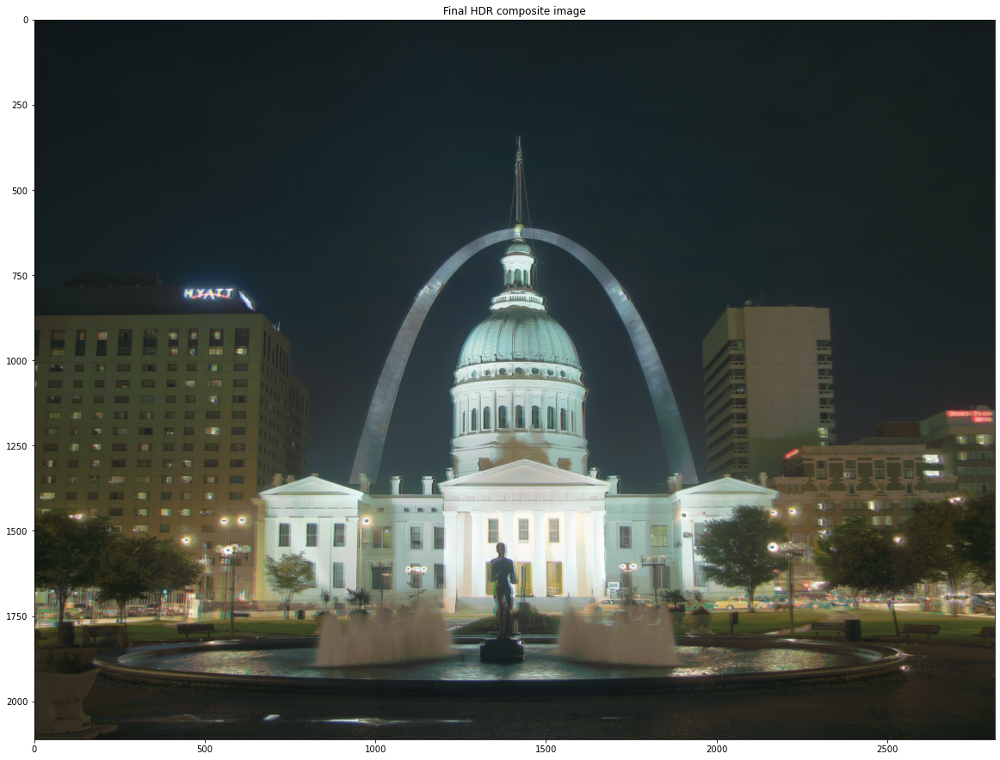

In [13]:
#apply tonemap and get displayable image
plt.figure(figsize=(20,20))
st_louis_im,ldr_im_bgr=apply_tonemap_reinhard(hdr)

#save image
cv2.imwrite(RESULTS_FOLDER+"StLouisArch_hdr.jpg",ldr_im_bgr)

#disply image
plt.title("Final HDR composite image")

plt.imshow(st_louis_im.astype(int))   
plt.show()

**Comments on the result:** The resulting image is nice! There is a considerable amount of detail in the monument building while also keeping the background buildings visible. Any individual image in the set would either blow out the colors on the monument building or would lose the background buildings in the shadows while trying to preserve them. Since both are visible here it shows that the HDR processing was able to produce a higher dynamic range. The only flaw is the ghosting around the statue and flag pole due to camera movement, but this will be addressed later in the project. 

## More examples

### Scene Window

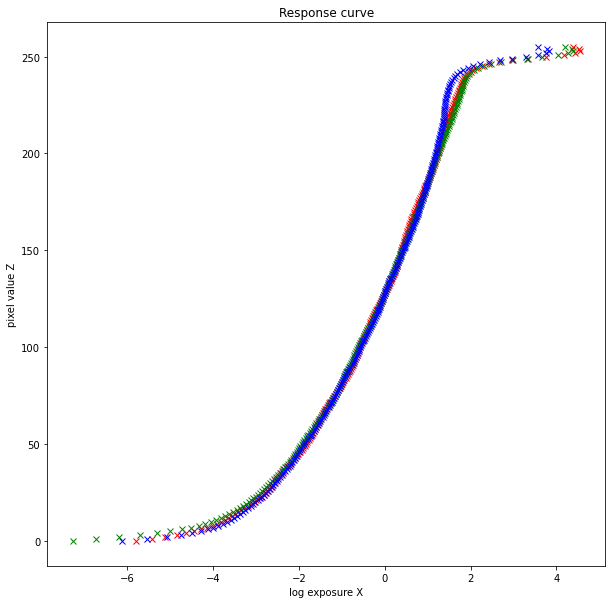

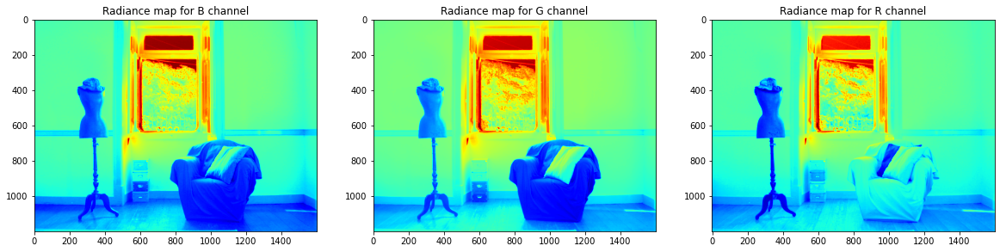

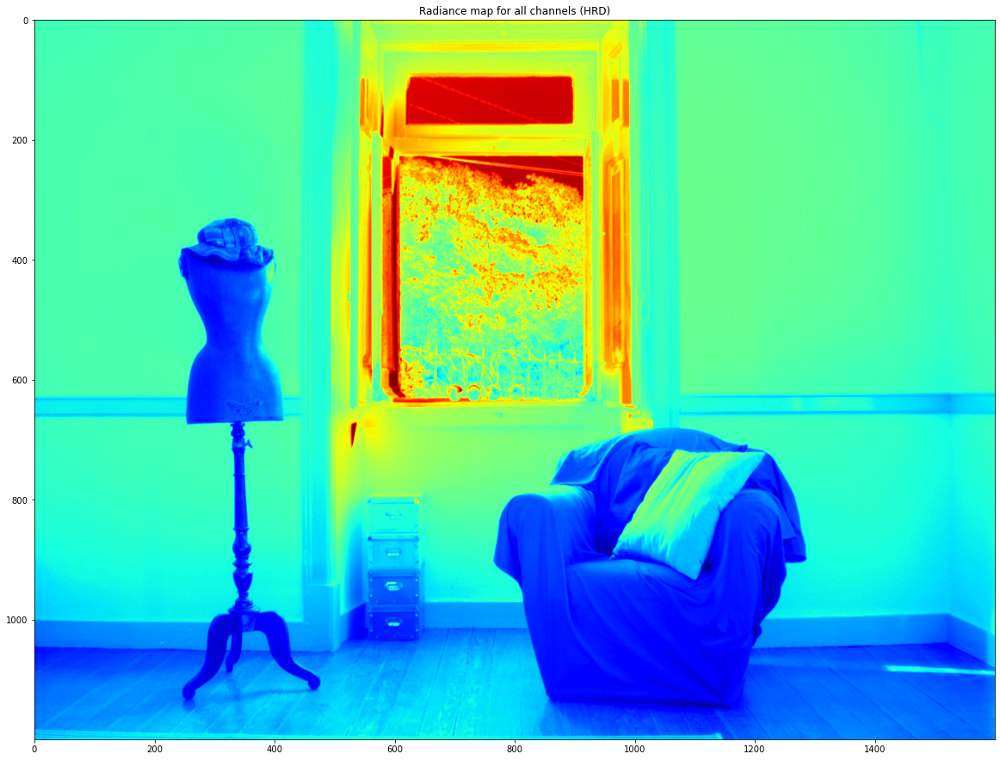

In [14]:
#gets img file names and exposure values from file
f_names, exposures= get_exposure_and_file_names(IMG_FOLDER+"scene_window_image_list.txt")
#load image from each RGB channel
im_b=load_images(f_names,IMG_FOLDER,0)
im_g=load_images(f_names,IMG_FOLDER,1)
im_r=load_images(f_names,IMG_FOLDER,2)

#estimate response functions for each channel
gr,_=hdr_debevec_malik(im_r,exposures)
gg,_=hdr_debevec_malik(im_g,exposures)
gb,_=hdr_debevec_malik(im_b,exposures)

#plot response\ functions
plot_response_curve([gr,gg,gb])

#construct hdr radience map
imgs=[im_b,im_g,im_r]
response_funcs=[gb,gg,gr]
hdr=construct_HDR([im_b,im_g,im_r],[gb,gg,gr],exposures,display_steps=True)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


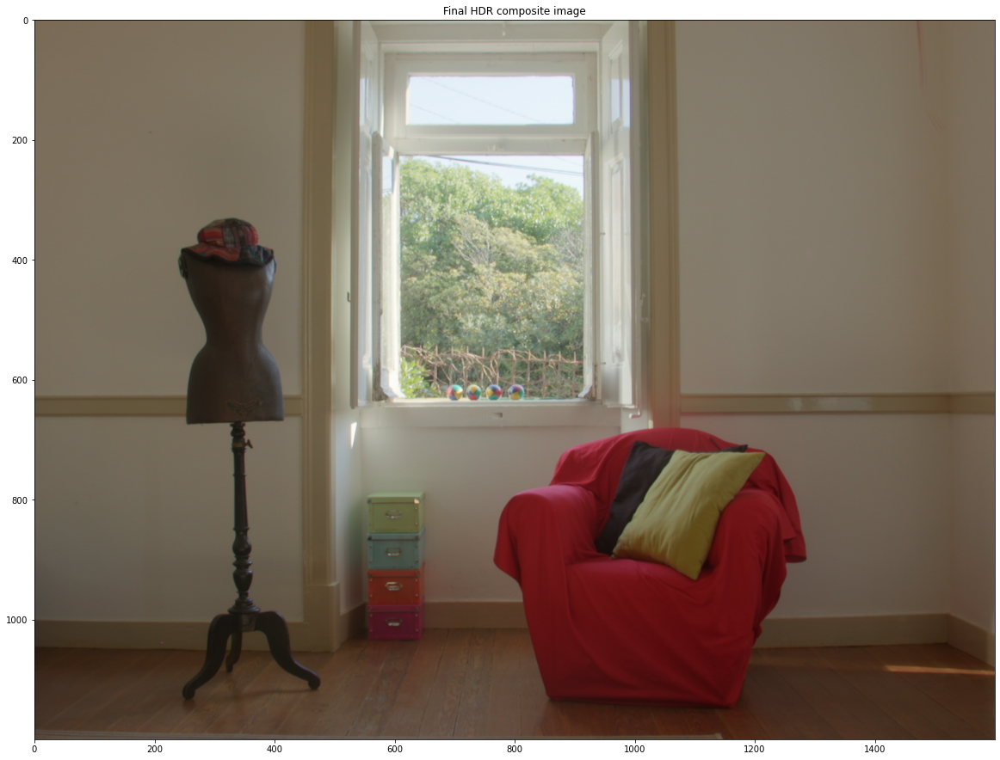

In [15]:

plt.figure(figsize=(20,20))
ldr_im,ldr_im_bgr=apply_tonemap_reinhard(hdr,[1.4, 1,0.5,0.5])
#save image
cv2.imwrite(RESULTS_FOLDER+"Scene_Window_hdr.jpg",ldr_im_bgr)

#disply image
plt.title("Final HDR composite image")
plt.imshow(ldr_im.astype(int))
    
plt.show()

**Comments on the result:** This was a very good example of the benefits of HDR. This image has very brightly lit and detailed foliage outside the window but it also has some dark regions on the floor, chair, and the mannequin.  No one exposure would likely be able to capture all the differently lit regions as such, it took no less than 12 differently exposed images to get this HDR composite image.

### Ostrów Tumski

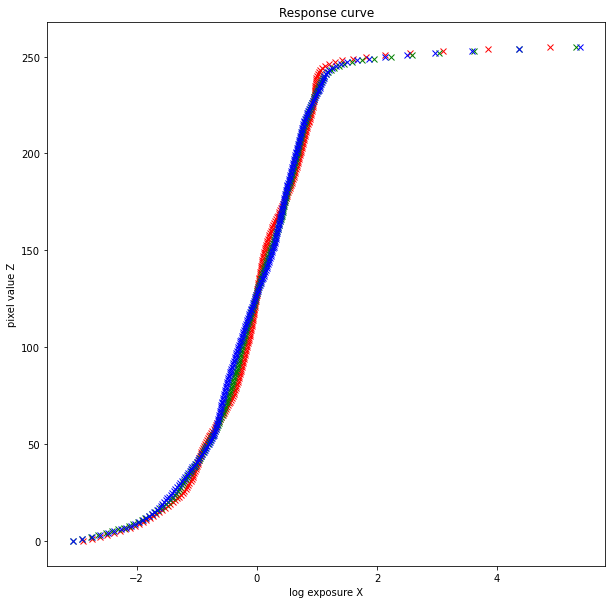

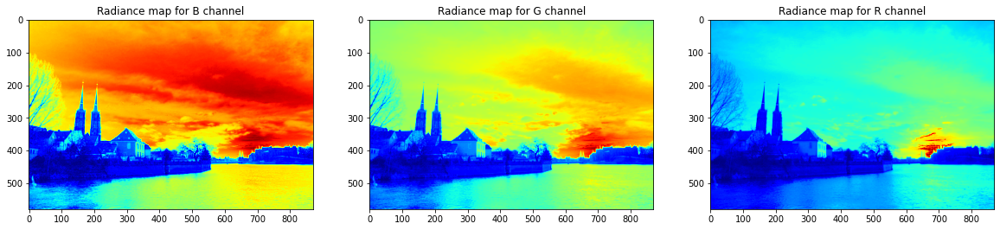

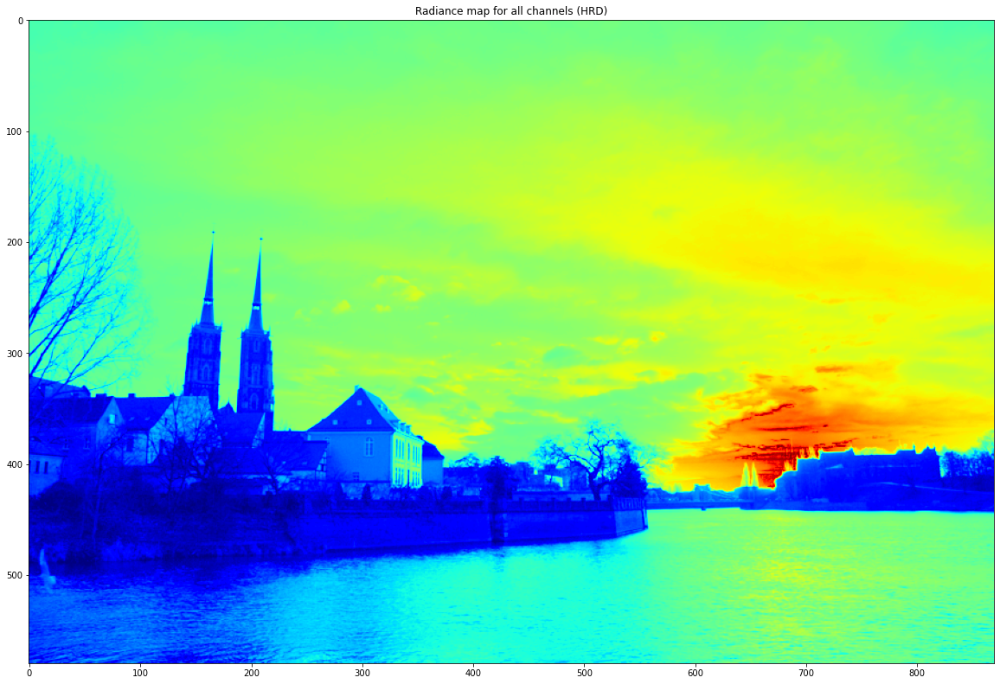

In [16]:
#gets img file names and exposure values from file
f_names, exposures= get_exposure_and_file_names(IMG_FOLDER+"ostrow-tumski_image_list.txt")
#load image from each RGB channel
im_b=load_images(f_names,IMG_FOLDER,0)
im_g=load_images(f_names,IMG_FOLDER,1)
im_r=load_images(f_names,IMG_FOLDER,2)

#estimate response functions for each channel
gr,_=hdr_debevec_malik(im_r,exposures)
gg,_=hdr_debevec_malik(im_g,exposures)
gb,_=hdr_debevec_malik(im_b,exposures)

#plot response functions
plot_response_curve([gr,gg,gb])

#construct hdr radience map
imgs=[im_b,im_g,im_r]
response_funcs=[gb,gg,gr]
hdr=construct_HDR([im_b,im_g,im_r],[gb,gg,gr],exposures,display_steps=True)


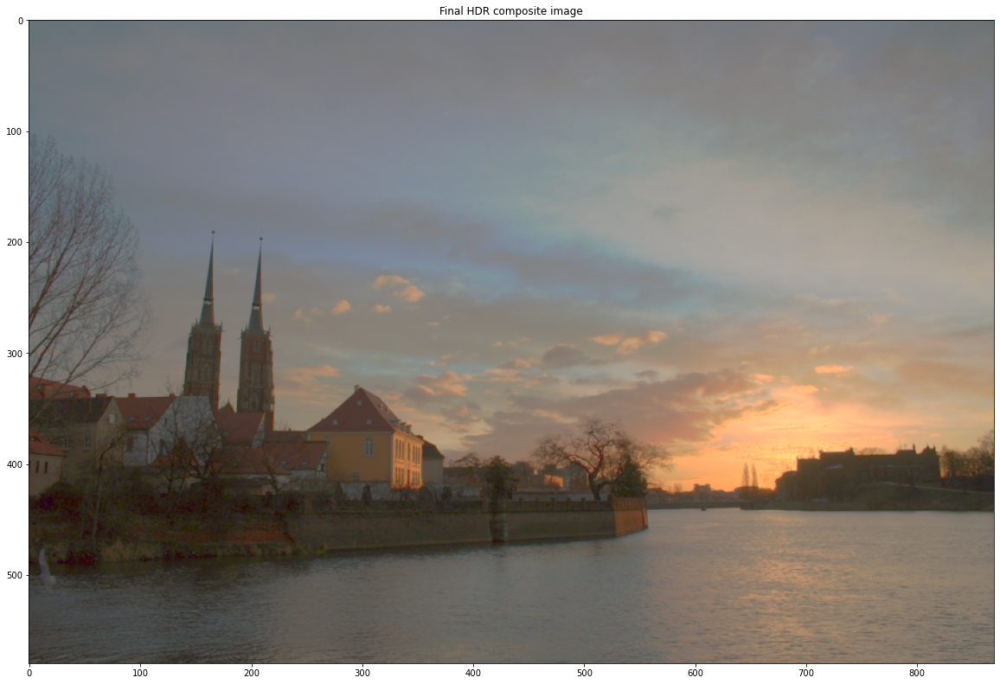

In [17]:

plt.figure(figsize=(20,20))
ldr_im,ldr_im_bgr=apply_tonemap_mantiuk(hdr,[1.6,0.8,1])
#save image
cv2.imwrite(RESULTS_FOLDER+"ostrow_tumski_hdr.jpg",ldr_im_bgr)

#disply image
plt.title("Final HDR composite image")

plt.imshow(ldr_im.astype(int))
    
plt.show()

**Comments on the result:** HDR was helpful here as it helped display the clouds being beautifully lit by the sun. Doing so would have been very difficult while also maintaining detail in the town buildings as the HDR has managed to do. It even managed to extract some detail from the buildings in the background that were silhouetted against the sunset.

## Mountains

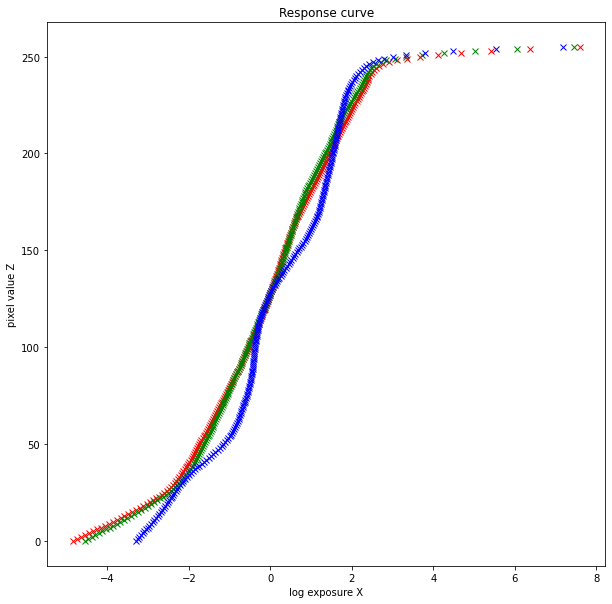

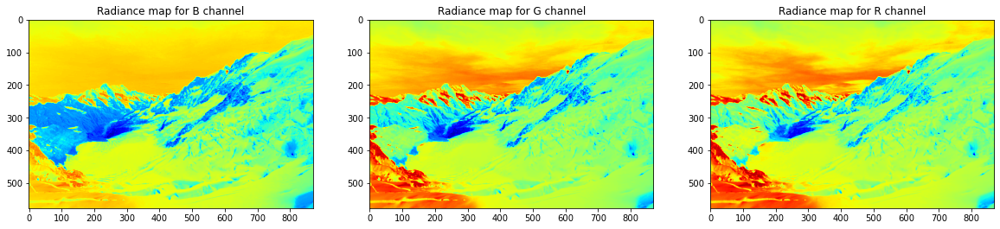

True

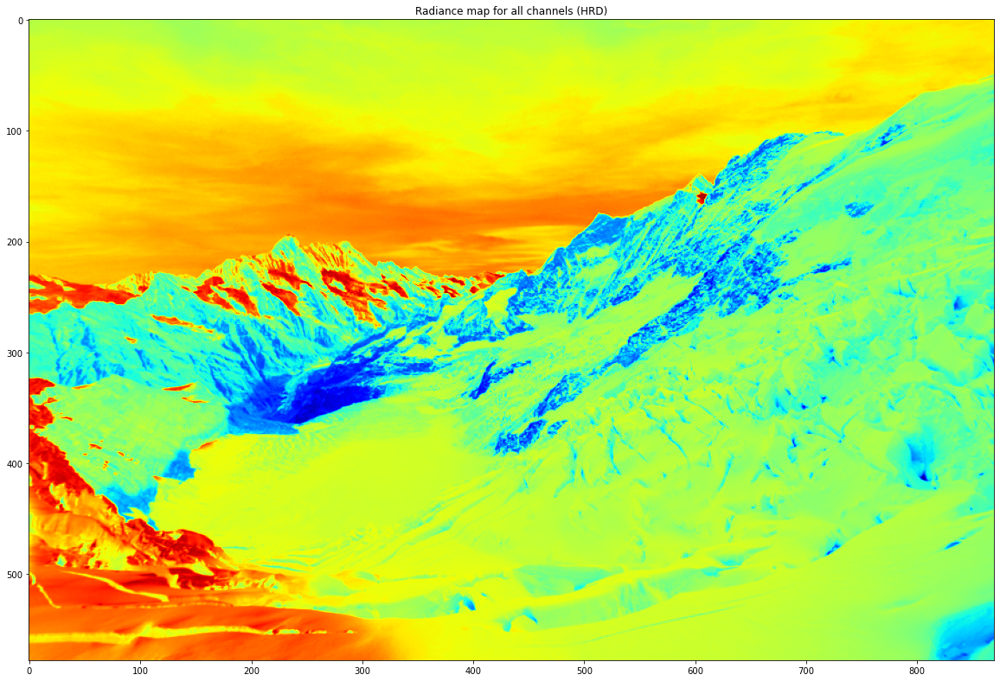

In [18]:
#gets img file names and exposure values from file
f_names, exposures= get_exposure_and_file_names(IMG_FOLDER+"mountains_image_list.txt")
#load image from each RGB channel
im_b=load_images(f_names,IMG_FOLDER,0)
im_g=load_images(f_names,IMG_FOLDER,1)
im_r=load_images(f_names,IMG_FOLDER,2)

#estimate response functions for each channel
gr,_=hdr_debevec_malik(im_r,exposures)
gg,_=hdr_debevec_malik(im_g,exposures)
gb,_=hdr_debevec_malik(im_b,exposures)

#plot response functions
plot_response_curve([gr,gg,gb])

#construct hdr radience map
imgs=[im_b,im_g,im_r]
response_funcs=[gb,gg,gr]
hdr=construct_HDR([im_b,im_g,im_r],[gb,gg,gr],exposures,display_steps=True)
cv2.imwrite("hdr.hdr",hdr)

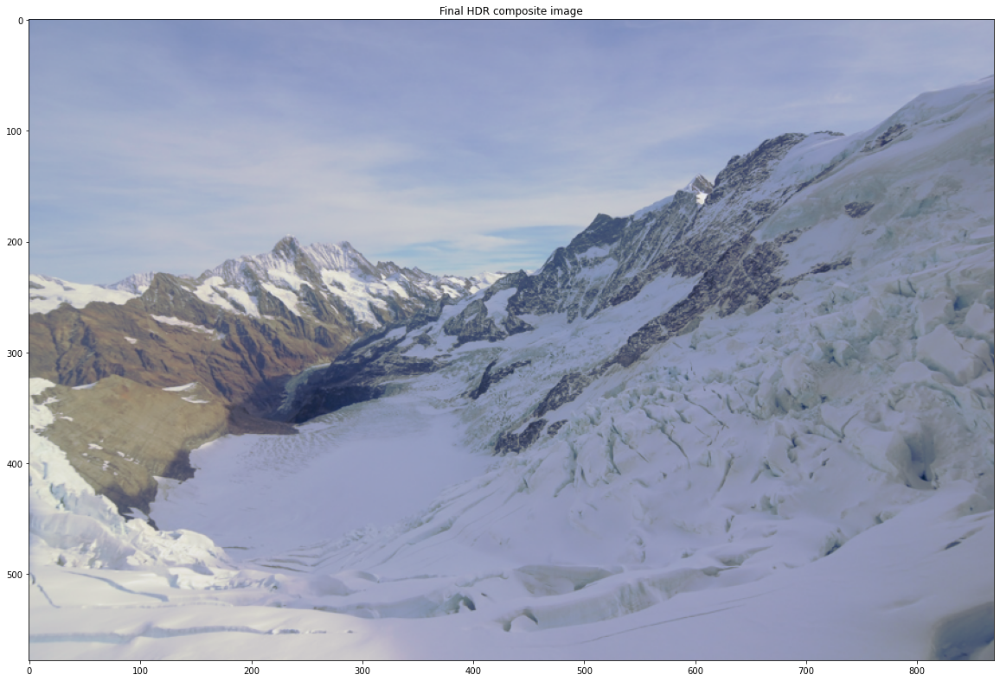

In [19]:

plt.figure(figsize=(20,20))
ldr_im,ldr_im_bgr=apply_tonemap_reinhard(hdr,[1.5, 0.5,0.5,0.5])
#save image
cv2.imwrite(RESULTS_FOLDER+"Mountains_hdr.jpg",ldr_im_bgr)

#disply image
plt.title("Final HDR composite image")

plt.imshow(ldr_im.astype(int))
    
plt.show()

**Comments on the result:** This scene never had an extremely high dynamic range, to begin with. However, applying HDR did bring out some detail in the rock face and sky.

## My own image

Here are some examples I took from my back deck. I was able to get different exposure by using the ‘manual camera’ app in ‘exposure bracketing’ mode and getting the exposure times in the image properties.

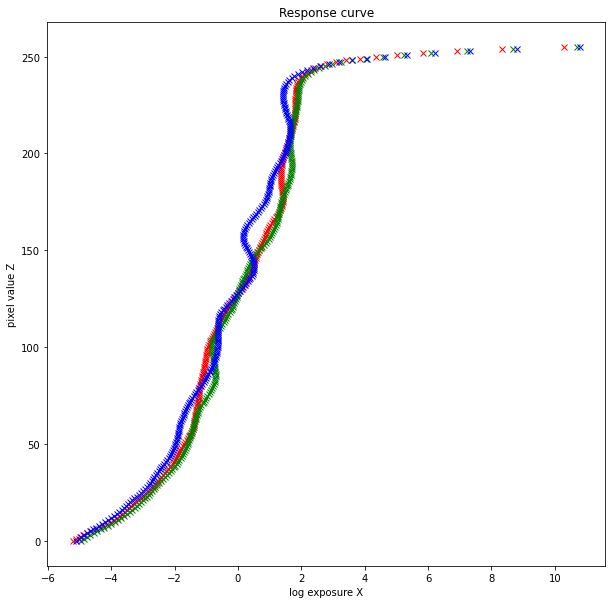

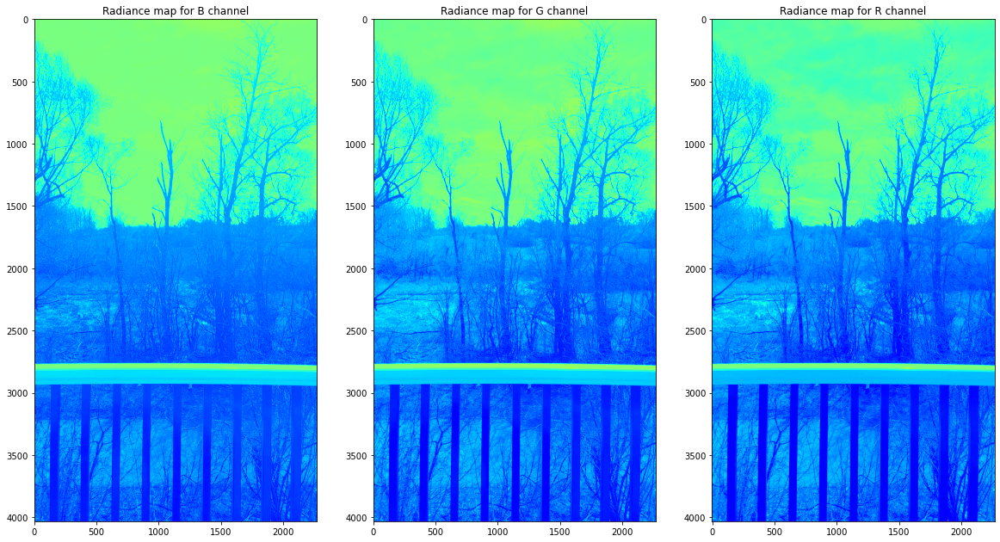

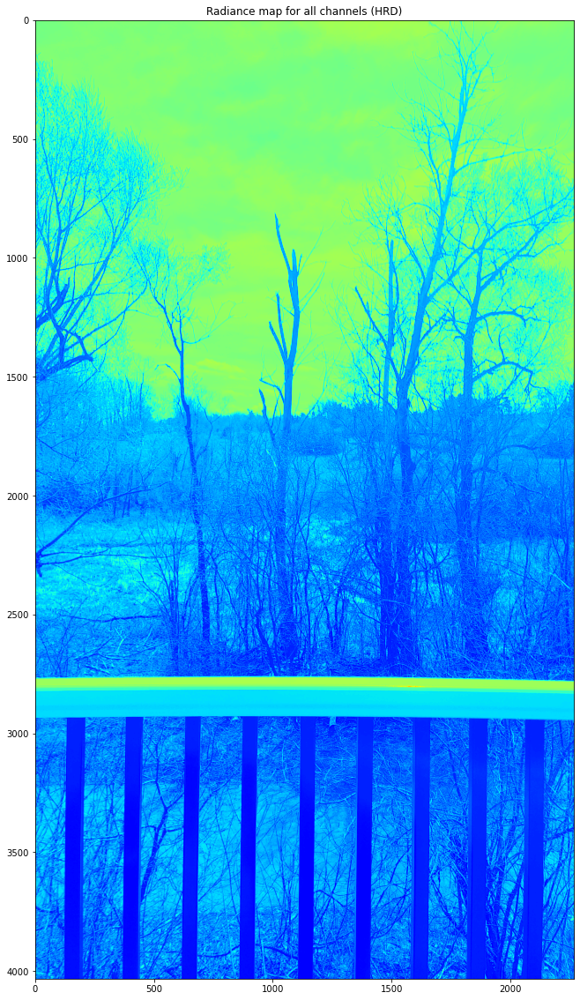

In [20]:
#gets img file names and exposure values from file
f_names, exposures= get_exposure_and_file_names(IMG_FOLDER+"tree_image_list.txt")
#load image from each RGB channel
im_b=load_images(f_names,IMG_FOLDER,0)
im_g=load_images(f_names,IMG_FOLDER,1)
im_r=load_images(f_names,IMG_FOLDER,2)

#estimate response functions for each channel
gr,_=hdr_debevec_malik(im_r,exposures)
gg,_=hdr_debevec_malik(im_g,exposures)
gb,_=hdr_debevec_malik(im_b,exposures)

#plot response functions
plot_response_curve([gr,gg,gb])

#construct hdr radience map
imgs=[im_b,im_g,im_r]
response_funcs=[gb,gg,gr]
hdr=construct_HDR([im_b,im_g,im_r],[gb,gg,gr],exposures,display_steps=True)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


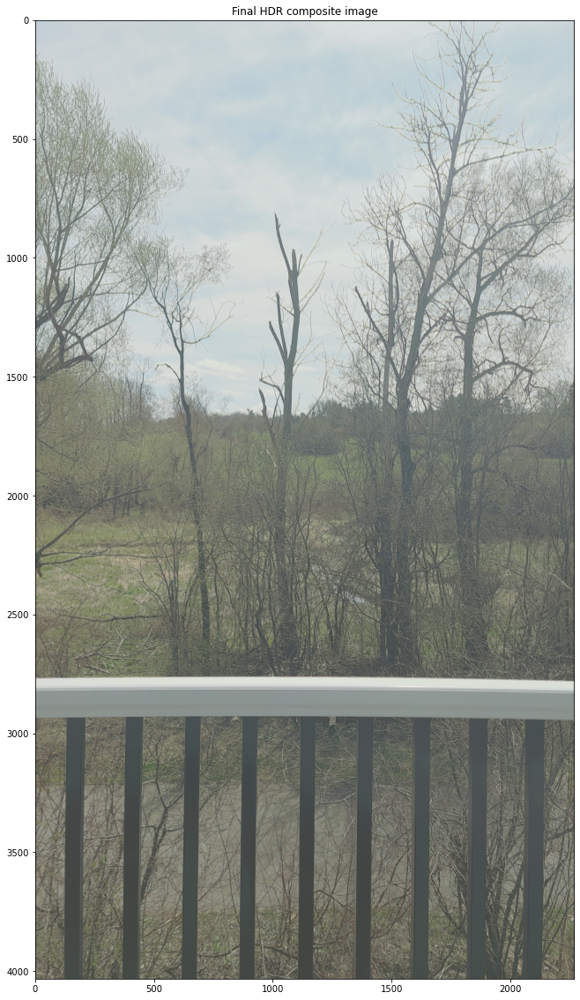

In [21]:
plt.figure(figsize=(20,20))
ldr_im,ldr_im_bgr=apply_tonemap_reinhard(hdr,[3, 0.5,0.0,0.0])
#save image
cv2.imwrite(RESULTS_FOLDER+"Tree_hdr.jpg",ldr_im_bgr)

#disply image
plt.title("Final HDR composite image")

plt.imshow(ldr_im.astype(int))

plt.show()

**Comments on the result:** In this scene the HDR was very useful in preserving the detail in the branches behind the black railing posts which would have been hard to get in a single exposure shot. It also made it possible to preserve the clouds and tree details at the top of the image. The only downside to this shot is that the tone mapping algorithm I used appears to work better with darker images and has washed out some of the bright vibrant colors.

In [22]:
#gets img file names and exposure values from file
f_names, exposures= get_exposure_and_file_names(IMG_FOLDER+"path_image_list.txt")
#load image from each RGB channel
im_b=load_images(f_names,IMG_FOLDER,0)
im_g=load_images(f_names,IMG_FOLDER,1)
im_r=load_images(f_names,IMG_FOLDER,2)

#estimate response functions for each channel
gr,_=hdr_debevec_malik(im_r,exposures)
gg,_=hdr_debevec_malik(im_g,exposures)
gb,_=hdr_debevec_malik(im_b,exposures)

#plot response functions
#plot_response_curve([gr,gg,gb])

#construct hdr radience map
imgs=[im_b,im_g,im_r]
response_funcs=[gb,gg,gr]
hdr=construct_HDR([im_b,im_g,im_r],[gb,gg,gr],exposures,display_steps=False)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


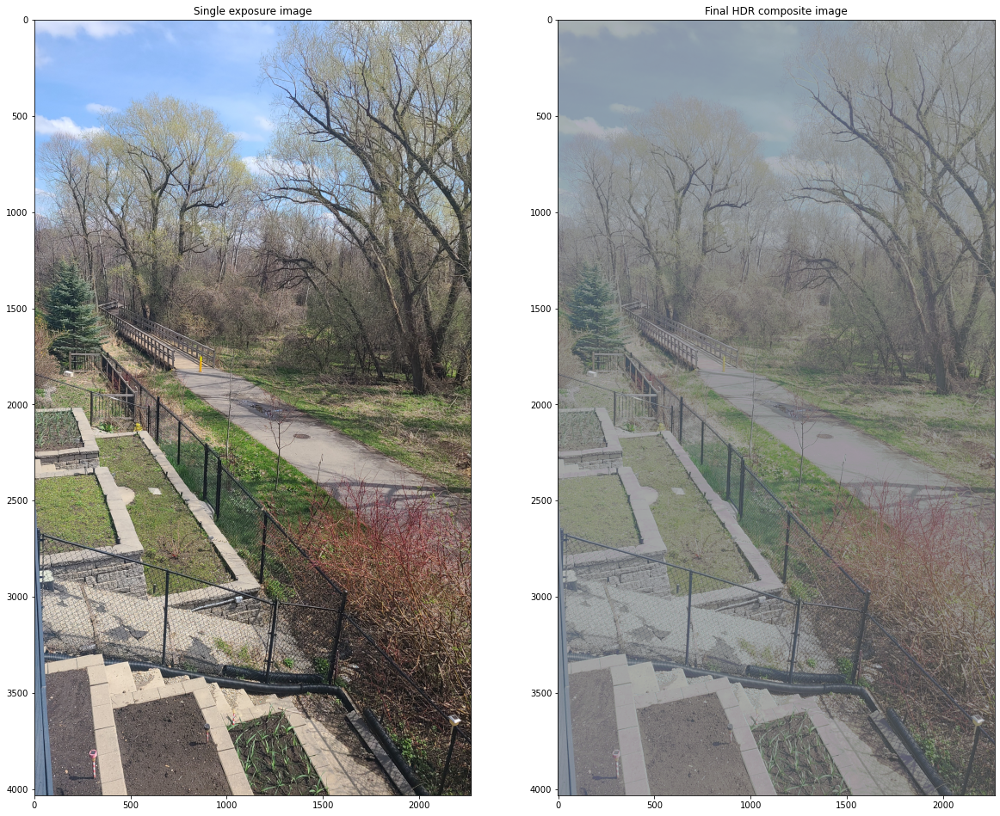

In [23]:
ldr_im,ldr_im_bgr=apply_tonemap_reinhard(hdr,[3, 0.5,0.0,0.0])

#save image
cv2.imwrite(RESULTS_FOLDER+"Path_hdr.jpg",ldr_im_bgr)

#disply HDR image vs single exposure
plt.figure(figsize=(20,20))
plt.subplot(121)
plt.title("Single exposure image")
im_og_exp = load_images(f_names,IMG_FOLDER)[1]
plt.imshow(im_og_exp)

plt.subplot(122)
plt.title("Final HDR composite image")

plt.imshow(ldr_im.astype(int))
    
plt.show()

**Comments on the result:** This image is a good example to show that not all images can benefit from HDR imaging. This scene was well lit by the sun and no region of the image was particularly dark or particularly bright. As such, a single exposure image was sufficient at capturing all detail and the full dynamic range. Arguably my HDR processing made the image less pleasing by tone mapping into a less vibrant color range.

## Image allignment 

One of the most notable flaws in the final image is the ghosting that can be seen in the St. Louis building’s spire and statue (see below figure). This is due to the camera shaking slightly between shots at different exposures. I will try to fix this by first aligning the images before applying the HDR processing.

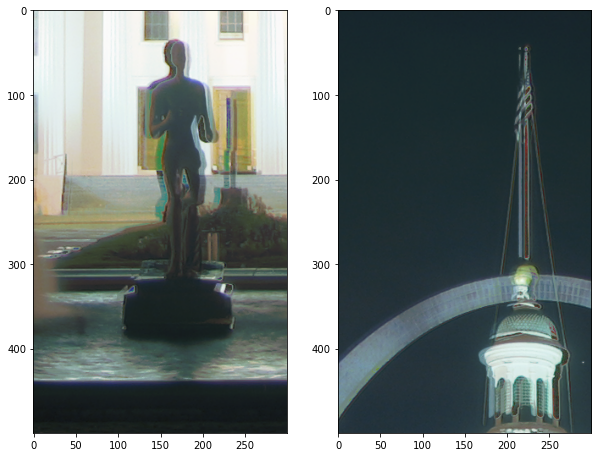

In [24]:
plt.figure(figsize=(10,10))
plt.subplot(1,2,1)

plt.imshow(st_louis_im[1500:2000,1200:1500,:].astype(int))
plt.subplot(1,2,2)
plt.imshow(st_louis_im[300:800,1200:1500,:].astype(int))

plt.show()

In [25]:
"""
-------------------------------------------------------------------------------------------------------------------------
Parameters: img (2d np arrays) - a array of image which has dimensions l x w, expected to be grayscale imagew
Description:Returns version of image with boosted contrast, 
    using histogram equalization : https://scikit-image.org/docs/dev/auto_examples/color_exposure/plot_equalize.html
--------------------------------------------------------------------------------------------------------------------------
"""
def histogram_eq(img):

    # Contrast stretching
    p2, p98 = np.percentile(img, (2, 98))
    img_rescale = exposure.rescale_intensity(img, in_range=(p2, p98))

    # Equalization
    img_eq = exposure.equalize_hist(img)

    # Adaptive Equalization
    img_adapteq = exposure.equalize_adapthist(img, clip_limit=0.03)
    return img_adapteq


In [26]:
"""
-------------------------------------------------------------------------------------------------------------------------
Parameters: imL (3d np arrays) - a array of image which has dimensions l x w x 3 for a 
                given image with 3 BGR (because cv2) channels, this is the base image that the other image will aligned to 
            imR (3d np arrays) - a array of image which has dimensions l x w x 3 for a 
            given image with 3 BGR (because cv2), this is the image that the other image will be realigned to imL
Description: Transforms and returns imL to align to imR, will align automatically using homographyestimation and 
                RANSAC as discussed in assignment 1

--------------------------------------------------------------------------------------------------------------------------
"""


def image_alignment(imL,imR,show_steps=False,percent_kp_used=0.15,boost_con=True):
    
    imLgray = rgb2gray(imL)
    imRgray = rgb2gray(imR)
    
    if boost_con:
        #use histogram equalization to make features more notable in darker images
        imRgray = histogram_eq(imRgray)
        imLgray = histogram_eq(imLgray)

        if show_steps:
            plt.figure(figsize=(10,10))
            plt.subplot(1,2,1)
            plt.title("Bosted contrast imL")
            plt.gray()
            plt.imshow(imLgray)

            plt.subplot(1,2,2)
            plt.title("Bosted contrast imR")
            plt.imshow(imRgray)
            plt.show()

    # NOTE: corner_peaks and many other feature extraction functions return point coordinates as (y,x), that is (rows,cols)
    #get keypoints from each image
    keypointsL = corner_peaks(corner_harris(imLgray), threshold_rel=0.0005, min_distance=6)
    keypointsR = corner_peaks(corner_harris(imRgray), threshold_rel=0.0005, min_distance=6)
    keypointsL=keypointsL[:int(len(keypointsL)*percent_kp_used)]
    keypointsR=keypointsR[:int(len(keypointsL)*percent_kp_used)]
    
    
    #print(len(keypointsL))
    #print(len(keypointsR))
    #print(keypointsR)
    
    
    extractor = BRIEF()
    extractor.extract(imLgray, keypointsL)
    keypointsL = keypointsL[extractor.mask]         
    descriptorsL = extractor.descriptors


    extractor.extract(imRgray, keypointsR)
    keypointsR = keypointsR[extractor.mask]
    descriptorsR = extractor.descriptors
    #print("start match")
    matchesLR = match_descriptors(descriptorsL, descriptorsR, cross_check=True)
    #print("matched")
    
    
    if show_steps:
        print ('the number of matches is {:2d}'.format(matchesLR.shape[0]))

        fig = plt.figure(1,figsize = (12, 4))
        axA = plt.subplot(111)
        plt.gray()
        plt.title("All detected matches")
        
        plot_matches(axA, imL, imR, keypointsL, keypointsR, matchesLR) #, matches_color = 'r')
        axA.axis('off')

        plt.show()

    #get cordinates of matching point
    matchL, matchR = keypointsL[matchesLR[:,0]], keypointsR[matchesLR[:,1]]

    #run ransac to get inliers
    model_transform, inliers = ransac((np.flip(matchR,axis=1), np.flip(matchL,axis=1)), ProjectiveTransform, min_samples=4, residual_threshold=5, max_trials=200)
    
    if show_steps:
        inlier_idxs = np.nonzero(inliers)[0]

        fig = plt.figure(2,figsize = (12, 4))
        axA = plt.subplot(111)
        plt.gray()
        plt.title("Inlier matches (after RANSAC)")
        plot_matches(axA, imL, imR, matchL, matchR , np.column_stack((inlier_idxs, inlier_idxs))) #, matches_color = 'r')
        axA.axis('off')

        plt.show()
        
    #get the projection for the right image using the ransac model 
    projectedR=warp(imR,model_transform.inverse,output_shape=(imLgray.shape[0],imLgray.shape[1]))
    
    return projectedR



## Discussing image alignment method	
In order to negate the flaw mentioned above, I aligned the images to reduce the ghosting. I used homograph estimation and RANSAC that I developed in assignment 1 to do so. The one addition I made to the algorithm from assignment 1 was to boost contrast of the grayscale image, using histogram equalization, doing so help the algorithm detect and match feature in low exposure (low contrast) images. The steps of the algorithm are shown below 


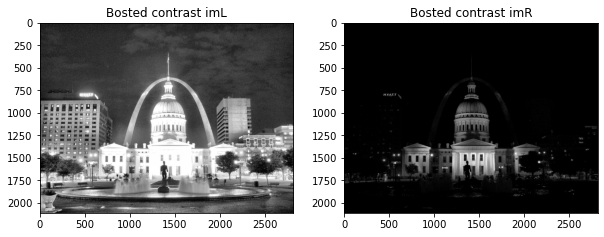

the number of matches is 172


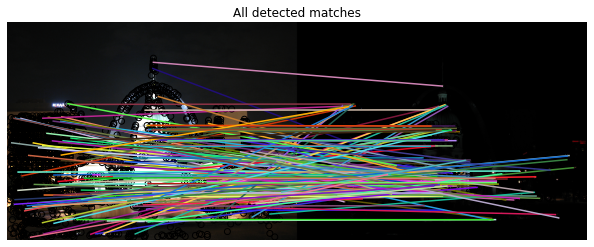

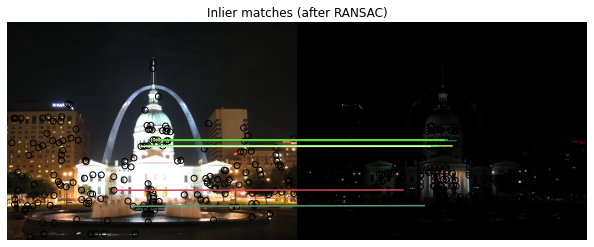

In [28]:
#gets img file names and exposure values 
f_names, exposures= get_exposure_and_file_names(IMG_FOLDER+"StLouisArch_image_list.txt")
#load imsges
images=load_images(f_names,IMG_FOLDER)
base_img=images[0]
mis_alig_img=images[-1]
alig_img=image_alignment(base_img,mis_alig_img,show_steps=True,)


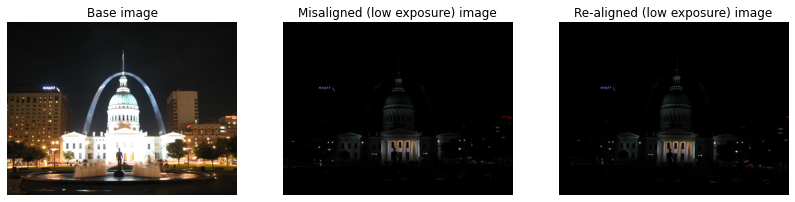

In [29]:

fig = plt.figure(figsize = (14, 16))

plt.subplot(131)
plt.axis('off')
plt.title("Base image")
plt.imshow(base_img)

plt.subplot(132)
plt.axis('off')
plt.title("Misaligned (low exposure) image")
plt.imshow(mis_alig_img)

plt.subplot(133)
plt.axis('off')
plt.title("Re-aligned (low exposure) image")
plt.imshow(alig_img)

plt.show()

Now we can have all the images be aligned to the first one by applying the alignment to all of them. The one assumption the I make is that the first image is relatively well aligned as it will be used as a reference to align the other images. 

In [30]:
"""
-------------------------------------------------------------------------------------------------------------------------
Parameters: images (list of images (3d np arrays)) - list of image array which has dimensions l x w x 3 for a 
                given image with 3 BGR (because cv2) channels, the first image is the base image that all other image
                will aligned to.
           
Description: Transforms and returns all images to align to the image at index 0, will align automatically using homography
                estimation and RANSAC as discussed in assignment 1

--------------------------------------------------------------------------------------------------------------------------
"""
def get_all_img_aligned(images,percent_kp_used=0.15,boost_con=True):
    base_img=images[0]#use 1st image and the reference
    aligned_imgs=[]
    aligned_imgs.append(base_img)
    
    print("Aligning images...")
    for i in range(1,len(images)):
        #align each image with the base image
        im_align=image_alignment(base_img,images[i],percent_kp_used=percent_kp_used,boost_con=boost_con)
        
        aligned_imgs.append(im_align*255)
        print("Aligning images...{}/{} completed.".format(i,len(images)-1))
    
    return aligned_imgs
    

In [31]:
%%time
#align each image with the base image
aligned_imgs=get_all_img_aligned(images)


Aligning images...
Aligning images...1/3 completed.
Aligning images...2/3 completed.
Aligning images...3/3 completed.
Wall time: 21.6 s


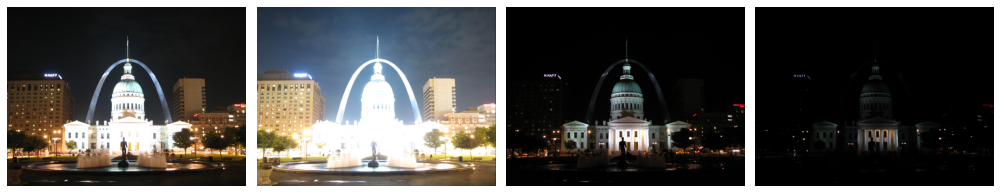

In [32]:
fig, axes = plt.subplots(nrows=1, ncols=len(aligned_imgs),figsize = (14, 16))
for im, ax in zip(aligned_imgs, axes.ravel()):
        
    ax.imshow(im.astype(int))
    ax.axis('off')
fig.tight_layout()
plt.show()

In [33]:
"""
-------------------------------------------------------------------------------------------------------------------------
Parameters: images (list of images (3d np arrays)) - list of image array which has dimensions l x w x 3 for a 
                given image with 3 BGR (because cv2) or RGB channels
            channel (int) [0,2] - the channel whos pixel values are to be returned
Description: Returns a list of images (2d array) while only returning values of the specified channel

--------------------------------------------------------------------------------------------------------------------------
"""
def get_channel_list(imgs,channel):
    channel_list=[]
    
    for img in imgs:
        channel_list.append(np.array(img[:,:,channel],dtype="uint8"))
    return channel_list

In [34]:
_, exposures= get_exposure_and_file_names(IMG_FOLDER+"StLouisArch_image_list.txt")

#seperate images into each RGB channel
im_r=get_channel_list(aligned_imgs,0)
im_g=get_channel_list(aligned_imgs,1)
im_b=get_channel_list(aligned_imgs,2)

#estimate response functions for each channel
gr,_=hdr_debevec_malik(im_r,exposures)
gg,_=hdr_debevec_malik(im_g,exposures)
gb,_=hdr_debevec_malik(im_b,exposures)


#construct hdr radience map
imgs=[im_b,im_g,im_r]
response_funcs=[gb,gg,gr]
hdr=construct_HDR([im_b,im_g,im_r],[gb,gg,gr],exposures,display_steps=False)

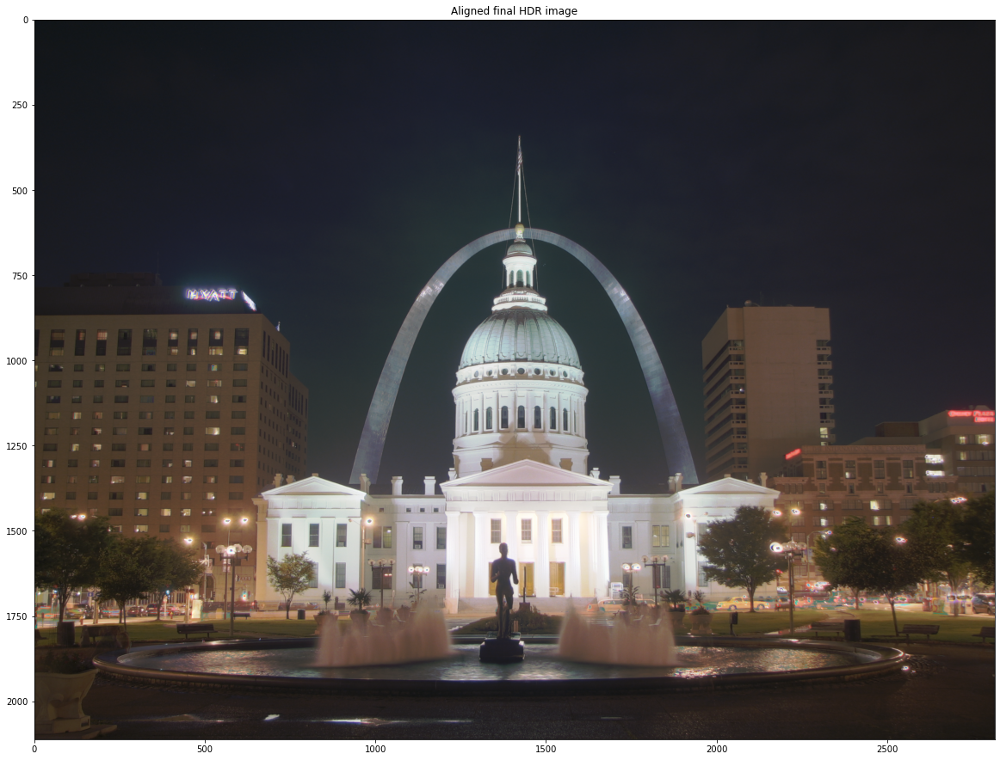

In [35]:
#apply tonemap and get displayable image
plt.figure(figsize=(20,20))
st_louis_im_aligned,ldr_im_bgr=apply_tonemap_reinhard(hdr)
#save image
cv2.imwrite(RESULTS_FOLDER+"StLouisArch_aligned_hdr.jpg",ldr_im_bgr)

#disply image
plt.subplot()
plt.title("Aligned final HDR image")
plt.imshow(st_louis_im_aligned.astype(int))
plt.show()

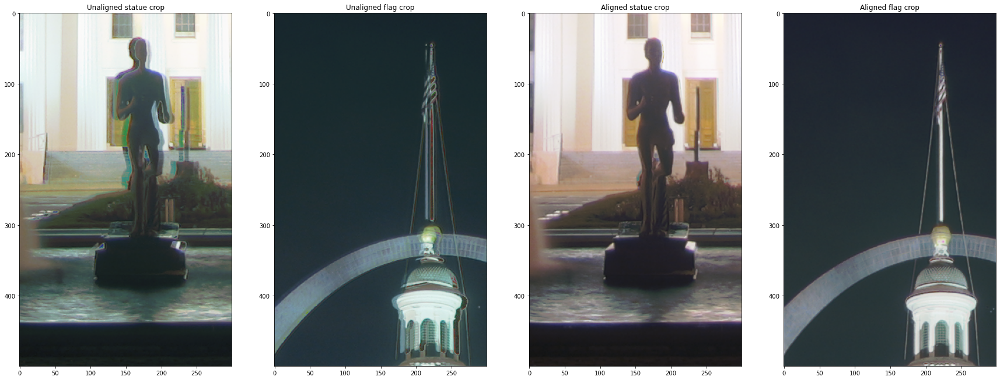

In [36]:
plt.figure(figsize=(30,20))

plt.subplot(1,4,1)
plt.title("Unaligned statue crop")
plt.imshow(st_louis_im[1500:2000,1200:1500,:].astype(int))
plt.subplot(1,4,2)
plt.title("Unaligned flag crop")
plt.imshow(st_louis_im[300:800,1200:1500,:].astype(int))

plt.subplot(1,4,3)
plt.title("Aligned statue crop")

plt.imshow(st_louis_im_aligned[1500:2000,1200:1500,:].astype(int))
plt.subplot(1,4,4)
plt.title("Aligned flag crop")
plt.imshow(st_louis_im_aligned[300:800,1200:1500,:].astype(int))


plt.show()

### Discussing experimental results and performance costs of aligning images 
The alignment algorithm did work. As can be seen in the figure above having, the images realigned to negate the affects of shaking the camera shake between shots. It greatly decreased the ghosting in the final HDR image, most notably around the statue and flag pole. The algorithm I used was effective, it produces a proper alignment almost every time I ran it. However, the algorithm was also fairly inefficient as it bottlenecked when matching features and could take up to 3 min align all images (assuming 3 images are being used). 

I tried exploring alternative methods such as using a CV2 based implementation of my algorithm. This was faster, however did not produce as reliable results and often would produce miss formed images. In the end I decided to stick with the stick to the slower more reliable alignment algorithm and only apply it on a case-by-case bases when ghosting is noticeable. 

After some further tinkering I was able to locate the bottleneck in the algorithm. The slow down was caused in the matching step where the matcher was trying to find matches between over 10000 key points in each image. To resolve this bottleneck, I restricted the algorithm to only use the first $n$ key points found in each image where $n$ is a percentage of the total number of key points found in each image. This percentage can be adjusted as a hyper-parameter to balance robustness and time perform for each image.

Lastly, I also experimented with making boosting contrast of the grayscale image a togglable option. I did so because it did help detect feature in really dark images like the one above but I also found that in other cases that had reasonable lighting it was a hindrance, like in my own sample below.


###  Using alignment on my own images

#### Sample 1

Aligning images...
Aligning images...1/2 completed.
Aligning images...2/2 completed.


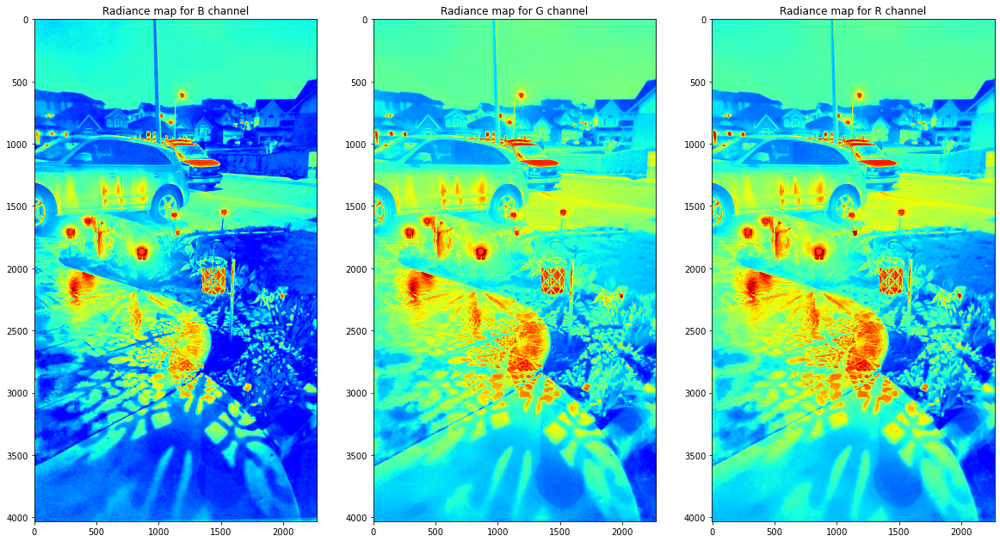

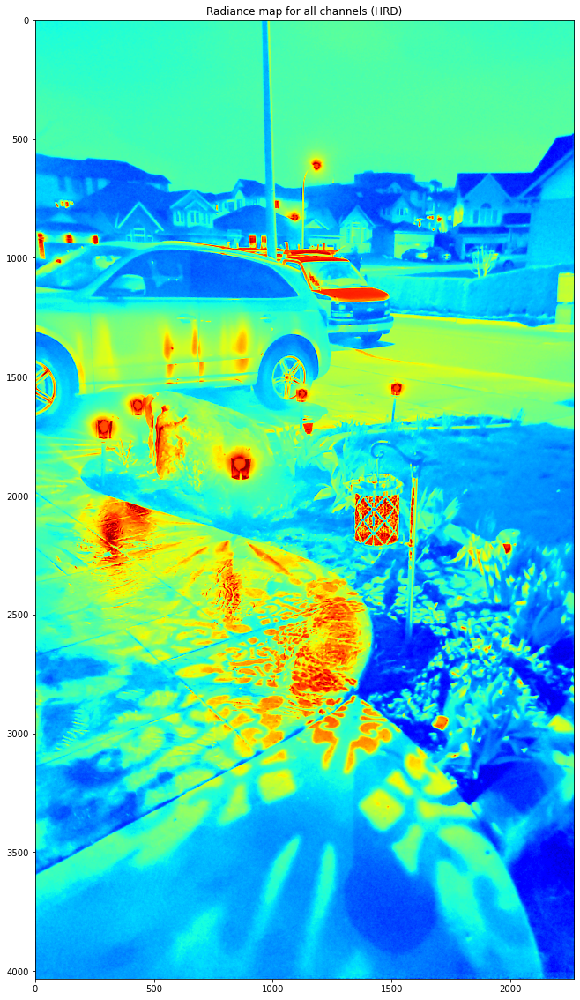

In [37]:
#gets img file names and exposure values 
f_names, exposures= get_exposure_and_file_names(IMG_FOLDER+"garden_image_list.txt")
#load imsges
images=load_images(f_names,IMG_FOLDER)

#align each image with the base image
aligned_imgs=get_all_img_aligned(images,0.4,False)

#seperate images into each RGB channel
im_r=get_channel_list(aligned_imgs,0)
im_g=get_channel_list(aligned_imgs,1)
im_b=get_channel_list(aligned_imgs,2)
#estimate response functions for each channel
gr,_=hdr_debevec_malik(im_r,exposures)
gg,_=hdr_debevec_malik(im_g,exposures)
gb,_=hdr_debevec_malik(im_b,exposures)


#construct hdr radience map
imgs=[im_b,im_g,im_r]
response_funcs=[gb,gg,gr]
hdr=construct_HDR([im_b,im_g,im_r],[gb,gg,gr],exposures,display_steps=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


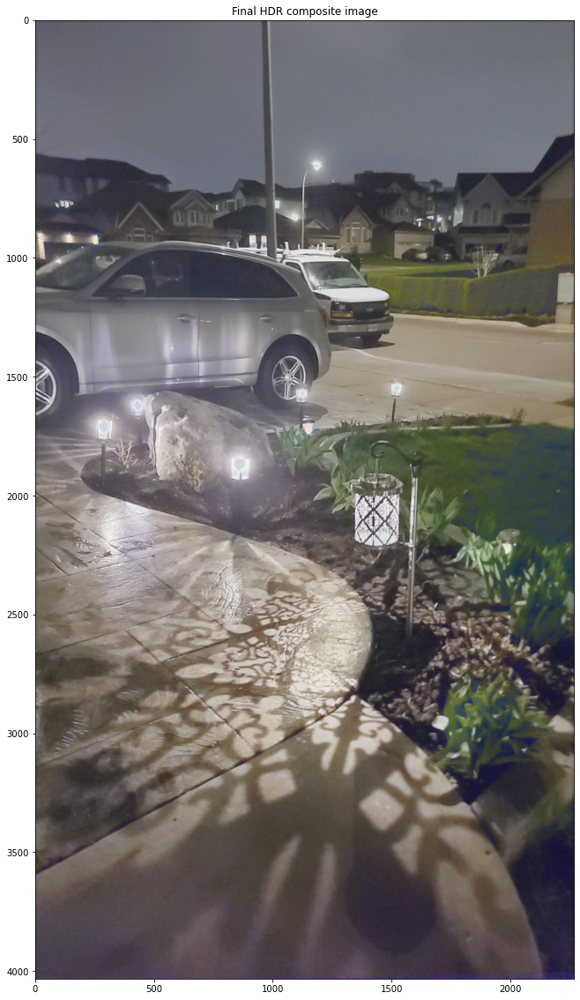

In [38]:
#apply and display tonemap
plt.figure(figsize=(20,20))
ldr_im,ldr_im_bgr=apply_tonemap_reinhard(hdr,[1.5, 0.5,0.5,0.5])
#save image
cv2.imwrite(RESULTS_FOLDER+"Garden_hdr.jpg",ldr_im_bgr)

#disply image
plt.title("Final HDR composite image")
plt.imshow(ldr_im.astype(int))
    
plt.show()

#### Sample 2

In [39]:
#gets img file names and exposure values 
f_names, exposures= get_exposure_and_file_names(IMG_FOLDER+"car_garden_image_list.txt")
#load imsges
images=load_images(f_names,IMG_FOLDER)

#align each image with the base image
aligned_imgs=get_all_img_aligned(images,0.4,False)

#seperate images into each RGB channel
im_r=get_channel_list(aligned_imgs,0)
im_g=get_channel_list(aligned_imgs,1)
im_b=get_channel_list(aligned_imgs,2)
#estimate response functions for each channel
gr,_=hdr_debevec_malik(im_r,exposures)
gg,_=hdr_debevec_malik(im_g,exposures)
gb,_=hdr_debevec_malik(im_b,exposures)


#construct hdr radience map
imgs=[im_b,im_g,im_r]
response_funcs=[gb,gg,gr]
hdr=construct_HDR([im_b,im_g,im_r],[gb,gg,gr],exposures,display_steps=False)

Aligning images...
Aligning images...1/2 completed.
Aligning images...2/2 completed.


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


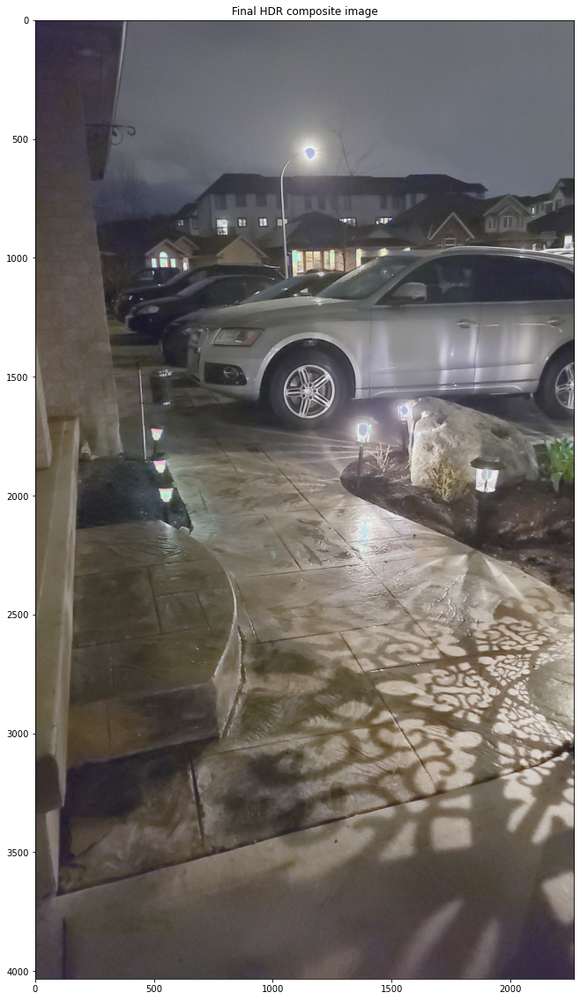

In [40]:
#apply and display tonemap
plt.figure(figsize=(20,20))
ldr_im,ldr_im_bgr=apply_tonemap_reinhard(hdr,[1.5, 0.5,0.5,0.5])
#save image
cv2.imwrite(RESULTS_FOLDER+"Car_hdr.jpg",ldr_im_bgr)

#disply image
plt.title("Final HDR composite image")
plt.imshow(ldr_im.astype(int))
    
plt.show()

**Comments on the two above results:** These two images above also required image alignment as there was significantly more wobble between shots, probably because the camera had chosen fairly long exposures, thus more time for the camera to shake in the hand. Once they had been aligned, the HDR did help produce better results in both cases. It helped combine images with good detail for the background houses with images that did not blow out the garden lights.

## Conclusion

A lot of modern photography mostly occurs on smartphones and this was the inspiration for exploring HDR in this project. Smartphones continue to improve in computational capabilities but are still limited in their camera abilities by their small sensor size which means they often can’t capture as much light and detail as a DSLR camera. Thus, these devices can benefit greatly from computational photography techniques like HDR imaging. As I have shown in this project HDR imaging using the Debevec-Malik Method can greatly increase the colors and detail that can be preserved in an image. It has shown to be especially effective in situations with very brightly lit and dark regions like in the sunset example of Ostrów Tumski. This allows devices with smaller sensors to still take stunning photos.

Since I had smartphones in mind, I wanted to extend this project by including auto-alignment. I felt this was an important extension given that sets of images taken on a smartphone were more likely to be misaligned given the use of a tripod is rare in smartphone photography and having properly aligned images is a requirement for HDR processing. For my auto-alignment implementation I used homographic estimation and RANSAC. I knew this method was robust from using assignment 1 however the fact that I needed to align images from different exposures presented a challenge.  This was mostly due to some of the under-exposed images being very dark and not being able to detect features. The solution to this was to have the option to boost the contrast of the dark images. This provided a robust solution for most low light (underexposed) photos. However, there are still some extreme cases such as when an underexposed image is almost totally pitch-black where the alignment can fail some of the time. I found no good algorithm or trick to deal with this case and the only solution would be to avoid using such dark images when alignment is required.

As can be seen above using the Debevec-Malik Method for HDR when combined with auto-alignment can produce very decent results but after experimenting with my implementation there are still a few drawbacks that I noticed. The first drawback is that although the auto-alignment can handle a slight shift in the frame, it cannot solve the ghosting artifacts that appear due to a moving object that appeared in only some of the exposure shots. These ghosting artifacts happened when a bird flew by in the bottom left corner of the Ostrów Tumski scene and when a taxi drove out of frame for some shots in the St. Louis Arch scene. Fixing these issues would likely require the moving objects to be manually edited out of some of the images or advanced recognition blending algorithms to remove them automatically.

The second flaw that I noticed in some images was that the colors appeared to be somewhat muted and washed out. Since the response function and radiance maps created by my implementation appear to be consistent with the examples in papers and online tutorials, it has lead me to conclude that the muted colors were likely due to my choice of tone mapping algorithms and the parameters are given to it. It appears that the Reinhard and Mantiuk tone mapping algorithms give the best results in darker, more neutral scenes. For future extensions to this project, I would recommend exploring more tone mapping algorithms (or trying to implement a novel one) that could give more vibrant results. Since after all the objective of many computational photography techniques like HDR images is to enhance the photos that we take so we can enjoy them.


## References and credits

### Works referenced

Debevec, P. E., & Malik, J. (2008). (2008). Recovering High Dynamic Range Radiance Maps from Photographs. Paper presented at the ACM SIGGRAPH 2008 Classes, Los Angeles, California. doi:10.1145/1401132.1401174

E. Reinhard, & K. Devlin. (2005). Dynamic range reduction inspired by photoreceptor physiology doi:10.1109/TVCG.2005.9

High-dynamic-range imaging . Retrieved from https://en.wikipedia.org/wiki/High-dynamic-range_imaging

Mallick, S. (2017, OCTOBER 2,). High Dynamic Range (HDR) Imaging using OpenCV (C++/Python). Retrieved from https://learnopencv.com/high-dynamic-range-hdr-imaging-using-opencv-cpp-python/#disqus_thread

Mantiuk, R., Myszkowski, K., & Seidel, H. (2006). A perceptual framework for contrast processing of high dynamic range images. ACM Transactions on Applied Perception (TAP), 3(3), 286-308.

Szeliski, R.Computer Vision: Algorithms and Applications

Tone Mapping. (2019, May 10,). Retrieved from https://64.github.io/tonemapping/#extended-reinhard-luminance-tone-map

### Image credits
- Images from the ‘Ostrów Tumski’ and ‘Mountains’ image sets are downloaded from https://www.easyhdr.com/examples/
- Images for the ‘StLouisArch’ image sets are By Kevin McCoy - Own work, CC BY-SA 3.0, https://commons.wikimedia.org/w/index.php?curid=7672583
- Images for the ‘Scene Window’ image sets are By Axel Jacobs (Photographer) - Axel Jacobs, WebHDR, CC BY-SA 2.0, https://commons.wikimedia.org/w/index.php?curid=6034049
- All other image where taken by myself, Amardeep Sarang using the Manual Camera app https://play.google.com/store/apps/details?id=com.lensesdev.manual.camera.pro&hl=en_CA&gl=US
